<html>
<body>
<h1 style = "color:blue"> Classify 10, 20 & 50 cent coins into two different categories</h1>

<h2 style = "color:red"> Abstract: </h2>
<p>The goal of this notebook is to build a convNN clasification using Tensor Flow library that is desinged to classify a given image of an euro coin into three different categories:.</p>
<p> a) Categorie 0 = 10 cents. </p>
<p> b) Categorie 1 = 20 cents. </p>
<p> c) Categorie 2 = 50 cents.

<h2 style = "color:red"> Dataset: </h2>
<p>The dataset employed in the training process is given by the Euro Coin dataset.</p>
</body>
</html>


In [1]:
import os, cv2, random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from coins_utils import *

TRAIN_DIR = 'CandidateDataSet2/resized_150_yuv_nobg_RAW/50centVs20centVs10cent/'

ROWS = 150
COLS = 150
CHANNELS = 3

images_full = [TRAIN_DIR+i for i in os.listdir(TRAIN_DIR) if '.jpg' in i]
random.shuffle(images_full)
n_images = len(images_full)
print("Number of images in full dataset "+str(n_images))
print("------------------------------------")


#Splitting of the input dataset into train, validation and test set.
train_to_full = 0.6 # Fraction of images used for training
validation_to_full = 0.8 # Fraction of images used for validation
train_to_full_index = int(n_images*train_to_full)
validation_to_full_index = int(n_images*validation_to_full)

#train_images = sorted(images_full[:train_to_full_index])
#validation_images =  sorted(images_full[train_to_full_index:validation_to_full_index])
#test_images =  sorted(images_full[validation_to_full_index:])

train_images = images_full[:train_to_full_index]
validation_images =  images_full[train_to_full_index:validation_to_full_index]
test_images =  images_full[validation_to_full_index:]

n_train_images = len(train_images)
n_validation_images = len(validation_images)
n_test_images = len(test_images)

print("Total number of train images "+str(n_train_images))
print("Total number of validation images "+str(n_validation_images))
print("Total number of test images "+str(n_test_images))
if n_train_images+n_validation_images+n_test_images - n_images != 0:
    print("Warning, there is a problem in the splitting of images")

train,maxTrain,minTrain = prep_data_nomean(train_images, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")
validation = prep_data_nomean_test(validation_images, maxTrain, minTrain, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")
test = prep_data_nomean_test(test_images, maxTrain, minTrain, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")

#trainPrint = prep_data(train_images, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")
#validationPrint = prep_data(validation_images, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")
#testPrint = prep_data(test_images, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")

#To make them easier to operate in future
train_images_name = [i.split('/')[-1] for i in train_images]
validation_images_name = [i.split('/')[-1] for i in validation_images]
test_images_name = [i.split('/')[-1] for i in test_images]
print(len(train_images_name), len(validation_images_name), len(test_images_name))

Using TensorFlow backend.


Number of images in full dataset 6768
------------------------------------
Total number of train images 4060
Total number of validation images 1354
Total number of test images 1354
Processed 0 of 4060
Processed 1000 of 4060
Processed 2000 of 4060
Processed 3000 of 4060
Processed 4000 of 4060
Processed 0 of 1354
Processed 1000 of 1354
Processed 0 of 1354
Processed 1000 of 1354
4060 1354 1354


# Getting the LABELS

In [2]:
## read the labels.
labels = pd.read_csv(TRAIN_DIR+'/labels_50centVs20centVs10cent.csv')

labels_train_df = labels[labels["FileName"].isin(train_images_name)]
labels_validation_df = labels[labels["FileName"].isin(validation_images_name)]
labels_test_df = labels[labels["FileName"].isin(test_images_name)]


#Example get the CoinType field and create array with labels (This is not very efficient...)
#iloc is there because for some reason it won't give me values with 'CoinType'.
nb_classes = 3
labels_train_nocategorical = []
for kitem in train_images_name:
        labels_train_nocategorical.append(labels[labels["FileName"] == kitem].iloc[0][3])   
labels_train_nocategorical= np.array(labels_train_nocategorical)
print('Train set labels read!')
    
labels_validation_nocategorical = []
for kitem in validation_images_name:
        labels_validation_nocategorical.append(labels[labels["FileName"] == kitem].iloc[0][3]) 
labels_validation_nocategorical= np.array(labels_validation_nocategorical)
print('Validation set labels read!')

labels_test_nocategorical = []
for kitem in test_images_name:
        labels_test_nocategorical.append(labels[labels["FileName"] == kitem].iloc[0][3])     
labels_test_nocategorical= np.array(labels_test_nocategorical)
print('Test set labels read!')


#Convert to categorical labels (vectors)
from keras.utils import np_utils
labels_train = np_utils.to_categorical(labels_train_nocategorical, nb_classes)
labels_validation = np_utils.to_categorical(labels_validation_nocategorical, nb_classes)
labels_test = np_utils.to_categorical(labels_test_nocategorical, nb_classes)

Train set labels read!
Validation set labels read!
Test set labels read!


# Sanity check, we are reading everything properly

P70210-173422_Candidate_10_150_Brightness_25.jpg
This is 20 cent
(150, 150, 3)


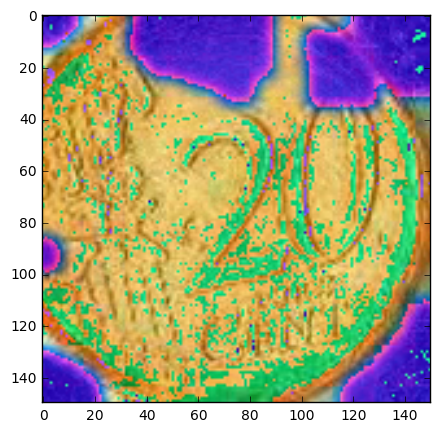

P70216-134049_Candidate_1_150_Brightness_25.jpg
This is 10 cent
(150, 150, 3)


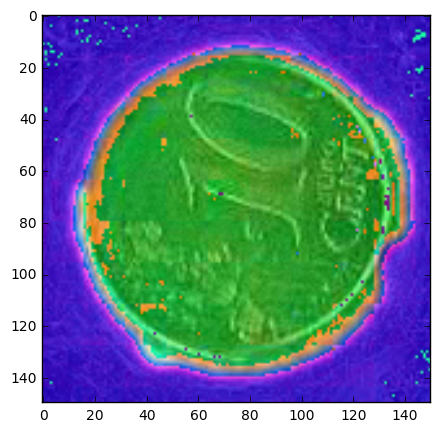

P70210-170638_Candidate_11_150_Brightness_-25.jpg
This is 50 cent
(150, 150, 3)


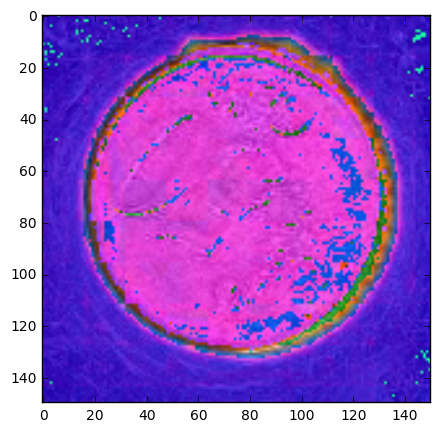

P70210-173511_Candidate_8_150_Brightness_-25.jpg
This is 20 cent
(150, 150, 3)


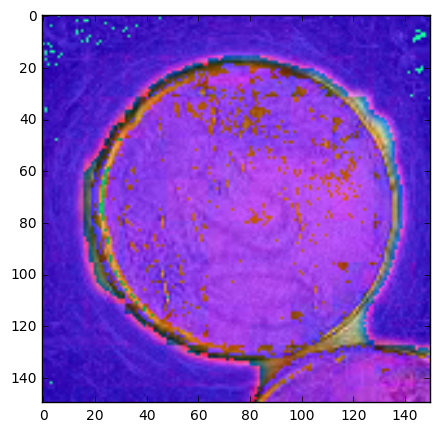

P70210-170101_Candidate_11_150_Brightness_0.jpg
This is 50 cent
(150, 150, 3)


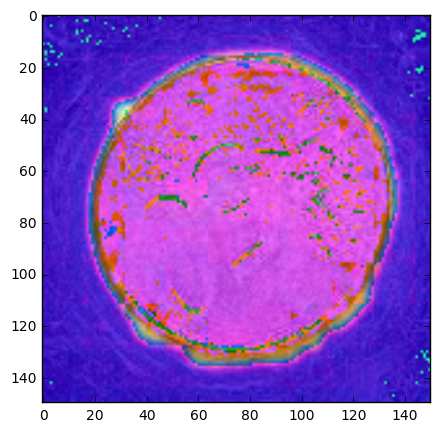

P70216-134859_Candidate_9_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


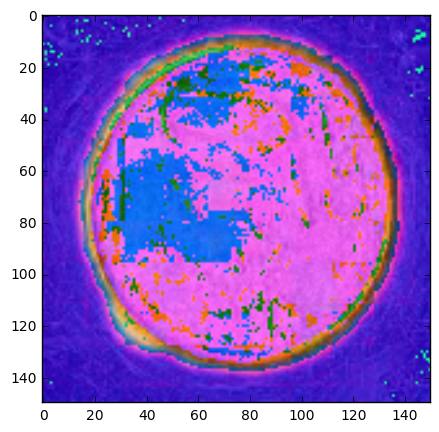

P70216-134243_Candidate_3_150_Brightness_0.jpg
This is 10 cent
(150, 150, 3)


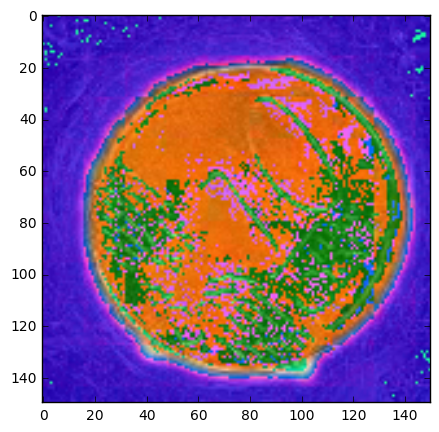

P70210-172856_Candidate_9_150_Brightness_25.jpg
This is 20 cent
(150, 150, 3)


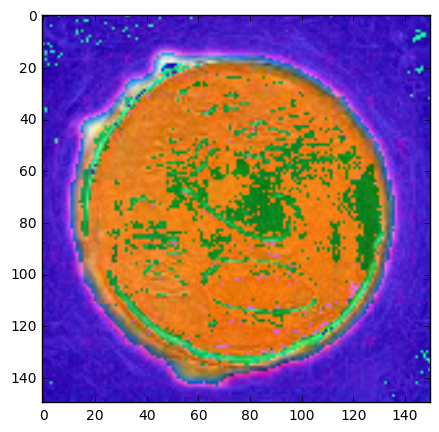

P70216-134504_Candidate_10_150_Brightness_25.jpg
This is 10 cent
(150, 150, 3)


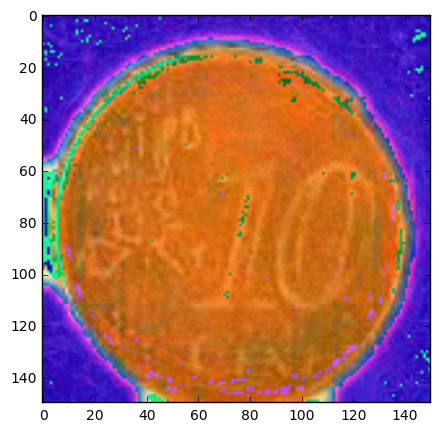

P70216-134915_Candidate_16_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


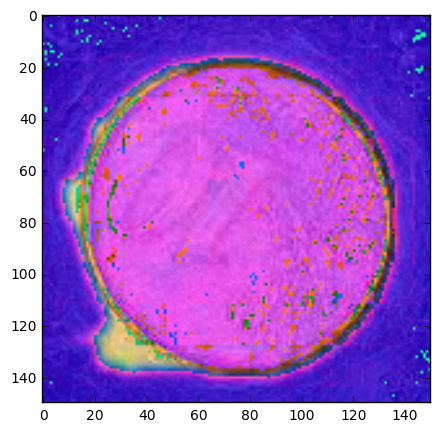

P70210-173538_Candidate_18_150_Brightness_0.jpg
This is 20 cent
(150, 150, 3)


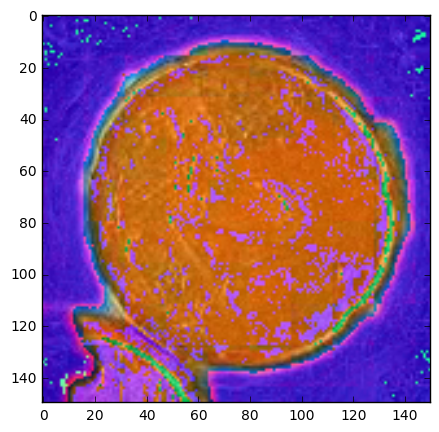

P70210-172941_Candidate_19_150_Brightness_-25.jpg
This is 20 cent
(150, 150, 3)


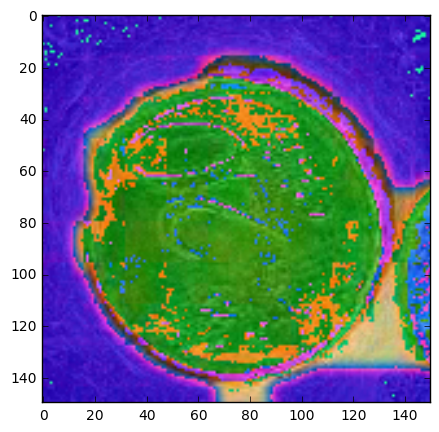

P70216-134111_Candidate_1_150_Brightness_0.jpg
This is 10 cent
(150, 150, 3)


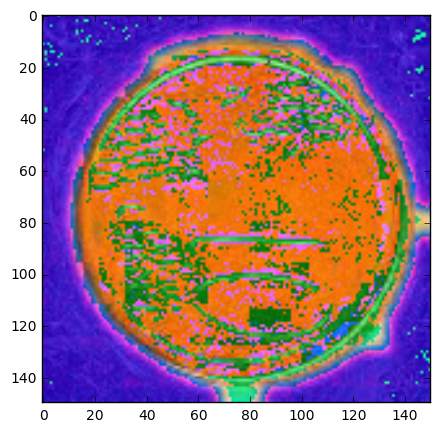

P70210-165858_Candidate_20_150_Brightness_25.jpg
This is 50 cent
(150, 150, 3)


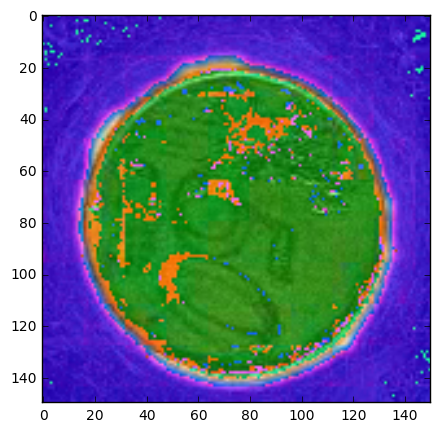

P70216-134839_Candidate_23_150_Brightness_0.jpg
This is 10 cent
(150, 150, 3)


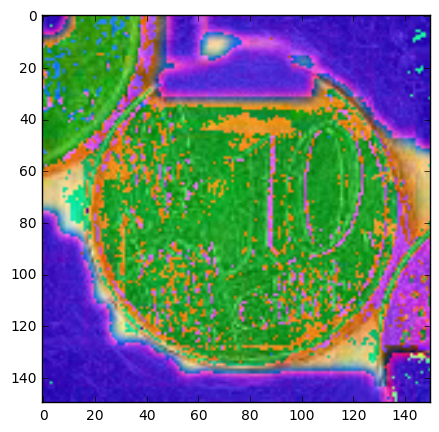

P70216-134808_Candidate_20_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


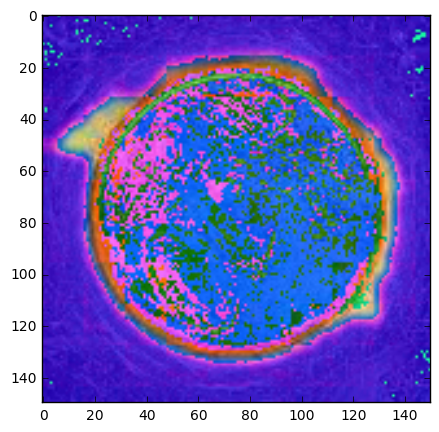

P70216-133950_Candidate_17_150_Brightness_0.jpg
This is 10 cent
(150, 150, 3)


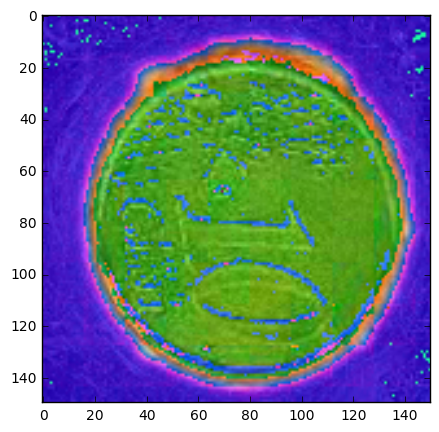

P70210-170459_Candidate_13_150_Brightness_-25.jpg
This is 50 cent
(150, 150, 3)


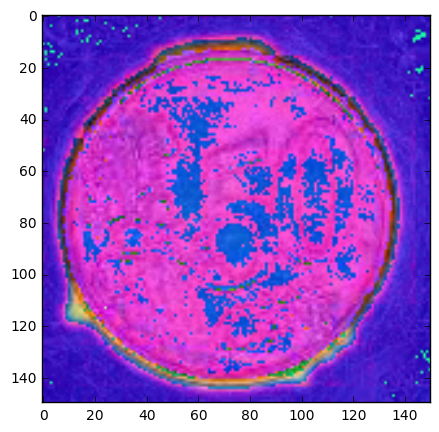

P70210-170524_Candidate_1_150_Brightness_0.jpg
This is 50 cent
(150, 150, 3)


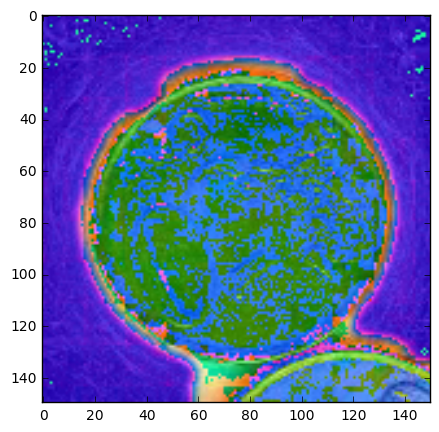

P70210-165550_Candidate_17_150_Brightness_0.jpg
This is 50 cent
(150, 150, 3)


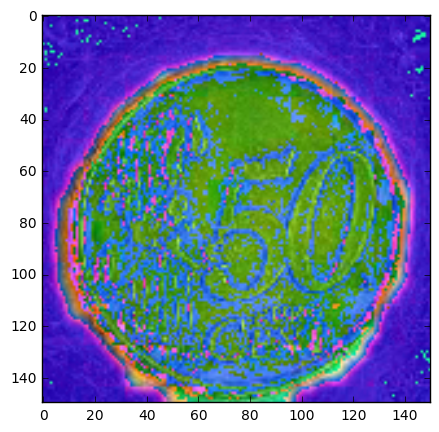

P70210-170036_Candidate_10_150_Brightness_0.jpg
This is 50 cent
(150, 150, 3)


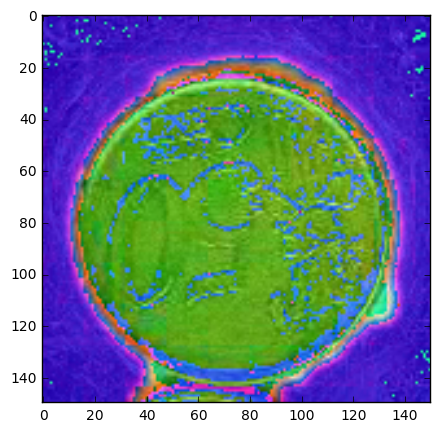

P70210-165530_Candidate_15_150_Brightness_25.jpg
This is 50 cent
(150, 150, 3)


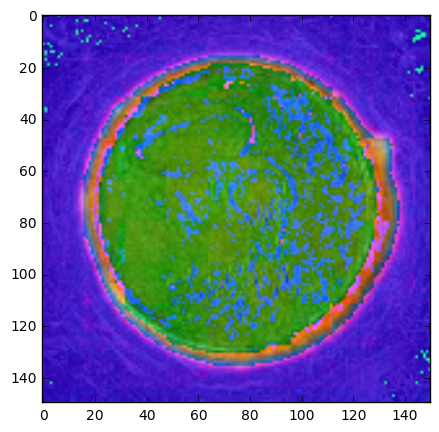

P70210-170326_Candidate_21_150_Brightness_0.jpg
This is 50 cent
(150, 150, 3)


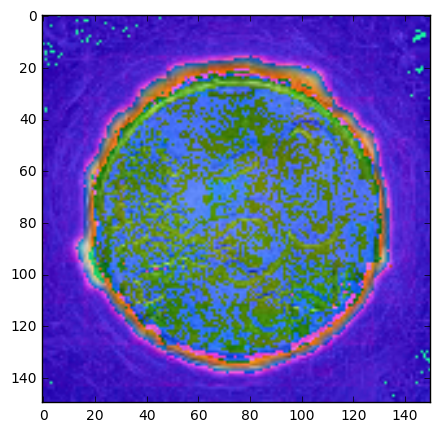

P70210-172818_Candidate_21_150_Brightness_0.jpg
This is 20 cent
(150, 150, 3)


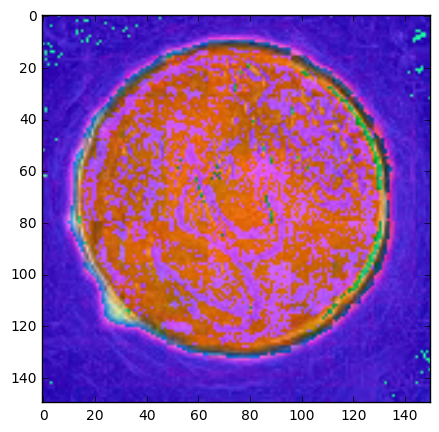

P70210-173538_Candidate_18_150_Brightness_25.jpg
This is 20 cent
(150, 150, 3)


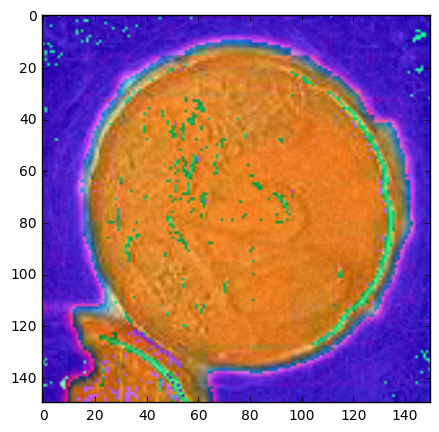

P70210-173511_Candidate_19_150_Brightness_-25.jpg
This is 20 cent
(150, 150, 3)


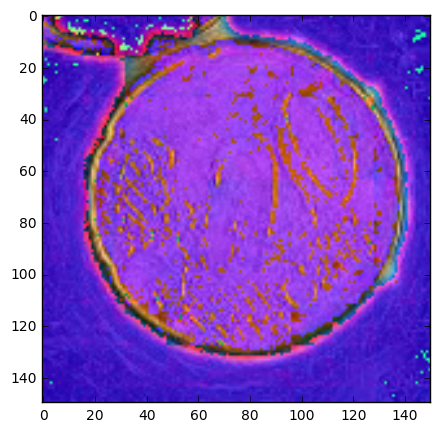

P70210-165837_Candidate_18_150_Brightness_0.jpg
This is 50 cent
(150, 150, 3)


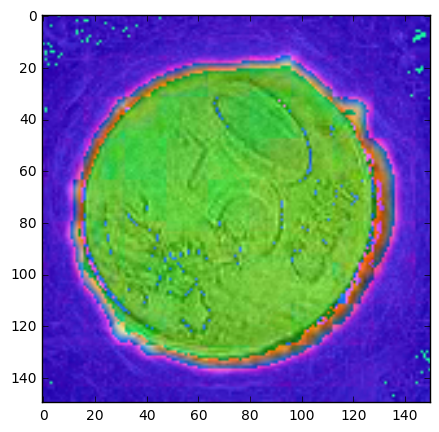

P70210-173403_Candidate_10_150_Brightness_0.jpg
This is 20 cent
(150, 150, 3)


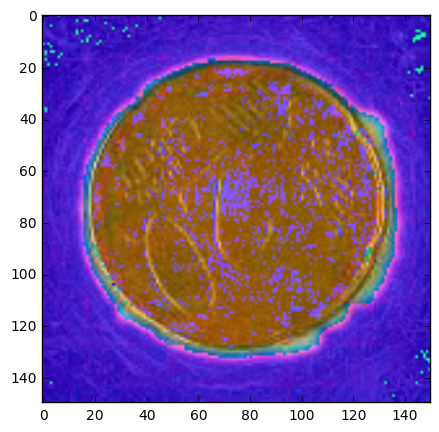

P70216-134319_Candidate_17_150_Brightness_0.jpg
This is 10 cent
(150, 150, 3)


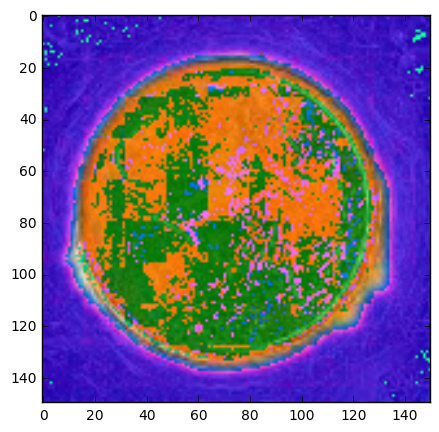

P70210-173056_Candidate_4_150_Brightness_25.jpg
This is 20 cent
(150, 150, 3)


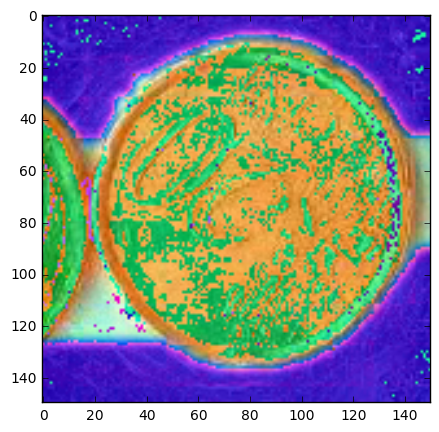

In [3]:
#Print some coins
def printSomeCoints(img, train_images_name, labels, ncoins):
    for i in range(0,ncoins):
        print(train_images_name[i])
        if labels[i] == 0.:
            print("This is 10 cent")
        if labels[i] == 1.:
            print("This is 20 cent")
        if labels[i] == 2.:
            print("This is 50 cent")
        plt.figure(figsize=(10,5))
        print(train[i].shape)
        plt.imshow(cv2.cvtColor(train[i], cv2.COLOR_YUV2RGB))
        plt.show()
    
    
printSomeCoints(train, train_images_name, labels_train_nocategorical, 30)

<html>
<body>
<h2 style = "color:red"> Building the classificator (work in progress..): </h2>
<p> Use the training dataset to build the classificator using a ConvNN.</p>
</body>
</html>

In [4]:
#Loading keras deep learnig libraries to build the model: https://keras.io/ 
from keras.layers import Input, Dense, Flatten, Dropout, Activation, advanced_activations, Convolution2D, MaxPooling2D
from keras.models import Model, model_from_json
from keras.optimizers import RMSprop
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from keras import initializations

## Standard Architecture

In [5]:
#Model hyperparameters
batch_size = 32 # in each iteration, we consider batch_size training examples at once
num_epochs = 50 # we iterate num_epochs times over the entire training set
kernel_size = 3 # we will use 3x3 kernels throughout
pool_size = 2 # we will use 2x2 pooling throughout
conv_depth_1 = 32 # we will initially have 32 kernels per conv. layer...
conv_depth_2 = 62 # ...switching to 64 after the first pooling layer
conv_depth_3 = 128 # ...switching to 64 after the first pooling layer
conv_depth_4 = 256 # ...switching to 64 after the first pooling layer
conv_depth_5 = 512 # ...switching to 64 after the first pooling layer
drop_prob_1 = 0.25 # dropout after pooling with this probability 
drop_prob_2 = 0.5 # dropout in the FC layer with this probability 
hidden_size = 32 # the FC layer will this neurons
data_augmentation = False # Whether to use or not data augmentation

NN = False
ConvNN = True
if ConvNN == True:
    #Architecture
    inp = Input(shape=(ROWS, COLS, CHANNELS)) # N.B. depth goes first in Keras!
    conv_1 = Convolution2D(conv_depth_1, kernel_size, kernel_size, border_mode='same', activation='relu')(inp)
    pool_1 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_1)
    conv_2 = Convolution2D(conv_depth_2, kernel_size, kernel_size, border_mode='same', activation='relu')(pool_1)
    pool_2 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_2)
    conv_3 = Convolution2D(conv_depth_3, kernel_size, kernel_size, border_mode='same', activation='relu')(pool_2)
    pool_3 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_3)
    conv_4 = Convolution2D(conv_depth_4, kernel_size, kernel_size, border_mode='same', activation='relu')(pool_3)
    pool_4 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_4)
    conv_5 = Convolution2D(conv_depth_5, kernel_size, kernel_size, border_mode='same', activation='relu')(pool_4)
                       

    flat = Flatten()(conv_5)
    hidden = Dense(hidden_size, activation='sigmoid')(flat)
    out = Dense(nb_classes, activation='sigmoid')(hidden)
    model = Model(input=inp, output=out) # To define a model, just specify its input and output layers

if NN == True:
    #Architecture
    inp = Input(shape=(ROWS, COLS, CHANNELS)) # N.B. depth goes first in Keras!                  
    flat = Flatten()(inp)
    hidden = Dense(hidden_size, activation='tanh')(flat)
    out = Dense(nb_classes, activation='sigmoid')(hidden)
    model = Model(input=inp, output=out) # To define a model, just specify its input and output layers

    
#print the summary of the architecture
model.summary()

#Visulize the model if desired
#from keras.utils.visualize_util import plot
#plot(model, to_file='Example_of_CNN_CatsVsDogs.pdf')

# reduce the learning rate by factor of 0.5 if the validation loss does not get lower in 7 epochs
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=0.0000001, verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=3, verbose=1, mode='auto')


# Let's train the model using SGD
#model.compile(loss='categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])
#model.compile(loss='categorical_crossentropy', optimizer='adagrad', metrics=['accuracy'])
model.compile(loss='categorical_crossentropy', optimizer=RMSprop(lr=1e-4), metrics=['accuracy'])

# Let's train the SGD model WITHOUT using data augmentation
if not data_augmentation:
    print('Not using data augmentation.')
    history = model.fit(train, labels_train, batch_size=batch_size, nb_epoch=num_epochs, validation_data=(validation, labels_validation), shuffle=True, callbacks=[reduce_lr,early_stopping])
    


____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 150, 150, 3)   0                                            
____________________________________________________________________________________________________
convolution2d_1 (Convolution2D)  (None, 150, 150, 32)  896         input_1[0][0]                    
____________________________________________________________________________________________________
maxpooling2d_1 (MaxPooling2D)    (None, 75, 75, 32)    0           convolution2d_1[0][0]            
____________________________________________________________________________________________________
convolution2d_2 (Convolution2D)  (None, 75, 75, 62)    17918       maxpooling2d_1[0][0]             
___________________________________________________________________________________________

## Reduced (And deeper) architecture

In [ ]:
#Model hyperparameters
batch_size = 32 # in each iteration, we consider batch_size training examples at once
num_epochs = 50 # we iterate num_epochs times over the entire training set
kernel_size = 3 # we will use 3x3 kernels throughout
pool_size = 2 # we will use 2x2 pooling throughout
conv_depth_1 = 32 # we will initially have 32 kernels per conv. layer...
conv_depth_2 = 62 # ...switching to 64 after the first pooling layer
conv_depth_3 = 128 # ...switching to 64 after the first pooling layer
conv_depth_4 = 256 # ...switching to 64 after the first pooling layer
conv_depth_5 = 512 # ...switching to 64 after the first pooling layer
conv_depth_6 = 1024 # ...switching to 64 after the first pooling layer
conv_depth_7 = 2048 # ...switching to 64 after the first pooling layer
drop_prob_1 = 0.25 # dropout after pooling with this probability 
drop_prob_2 = 0.5 # dropout in the FC layer with this probability 
hidden_size = 16 # the FC layer will this neurons
data_augmentation = False # Whether to use or not data augmentation

NN = False
ConvNN = True
if ConvNN == True:
    #Architecture
    inp = Input(shape=(ROWS, COLS, CHANNELS)) # N.B. depth goes first in Keras!
    conv_1 = Convolution2D(conv_depth_1, kernel_size, kernel_size, border_mode='same', activation='tanh')(inp)
    pool_1 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_1)
    conv_2 = Convolution2D(conv_depth_2, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_1)
    pool_2 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_2)
    conv_3 = Convolution2D(conv_depth_3, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_2)
    pool_3 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_3)
    conv_4 = Convolution2D(conv_depth_4, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_3)
    pool_4 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_4)
    conv_5 = Convolution2D(conv_depth_5, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_4)
    pool_5 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_5)
    conv_6 = Convolution2D(conv_depth_6, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_5)
                       

    flat = Flatten()(conv_6)
    hidden = Dense(hidden_size, activation='tanh')(flat)
    out = Dense(nb_classes, activation='sigmoid')(hidden)
    model = Model(input=inp, output=out) # To define a model, just specify its input and output layers

if NN == True:
    #Architecture
    inp = Input(shape=(ROWS, COLS, CHANNELS)) # N.B. depth goes first in Keras!                  
    flat = Flatten()(inp)
    hidden = Dense(hidden_size, activation='tanh')(flat)
    out = Dense(nb_classes, activation='sigmoid')(hidden)
    model = Model(input=inp, output=out) # To define a model, just specify its input and output layers

    
#print the summary of the architecture
model.summary()

#Visulize the model if desired
#from keras.utils.visualize_util import plot
#plot(model, to_file='Example_of_CNN_CatsVsDogs.pdf')

# reduce the learning rate by factor of 0.5 if the validation loss does not get lower in 7 epochs
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=0.0000001, verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=3, verbose=1, mode='auto')


# Let's train the model using SGD
#model.compile(loss='categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])
#model.compile(loss='categorical_crossentropy', optimizer='adagrad', metrics=['accuracy'])
model.compile(loss='categorical_crossentropy', optimizer=RMSprop(lr=1e-4), metrics=['accuracy'])

# Let's train the SGD model WITHOUT using data augmentation
if not data_augmentation:
    print('Not using data augmentation.')
    history = model.fit(train, labels_train, batch_size=batch_size, nb_epoch=num_epochs, validation_data=(validation, labels_validation), shuffle=True, callbacks=[reduce_lr,early_stopping])
                            
                       

# Learning curves (check the performance)

dict_keys(['loss', 'acc', 'val_loss', 'val_acc', 'lr'])


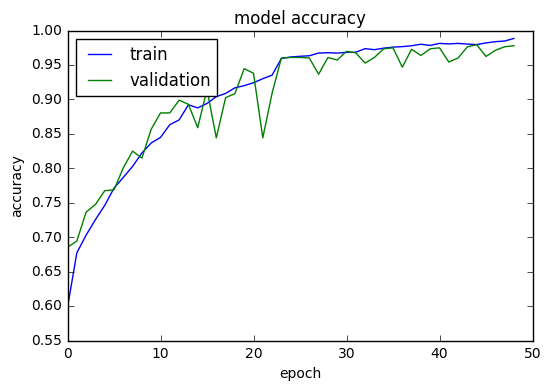

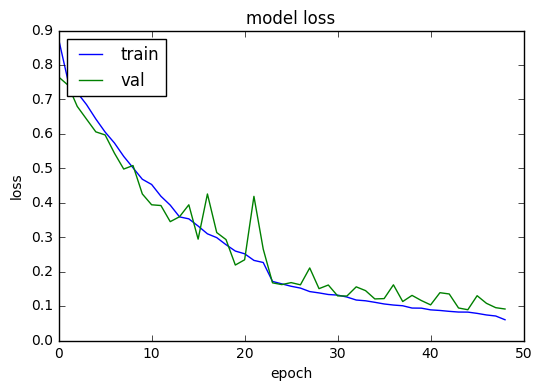

In [6]:
# list all data in history
print(history.history.keys())

# summarize history for accuracy
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
plt.savefig('Accuracy_Example_Coin_Classifier_GoldenCoins.pdf')
plt.close()


# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig('Loss_Example_Coin_Classifier_GoldenCoins.pdf')
plt.close()

# Save 

In [7]:
#SaveModel(model, "Model_Example_Coin_Classifier_GoldenCoins_Standard_yuv") #For the standard architecture
#SaveModel(model, "Model_Example_Coin_Classifier_GoldenCoins_Reduced_yuv") #For the reduced architecture
#SaveModel(model, "Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_yuv") #For the reduced deeper architecture
SaveModel(model, "Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_nobg_yuv") #For the reduced deeper architecture

Saved model Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_nobg_yuv to disk


0

# Load and Test model

Loaded model Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_nobg_yuv from disk 

PREDICTIONS 

 0.00875787 of 10 cents 

 0.80599272 of 20 cents 

 0.00469523 of 50 cents 



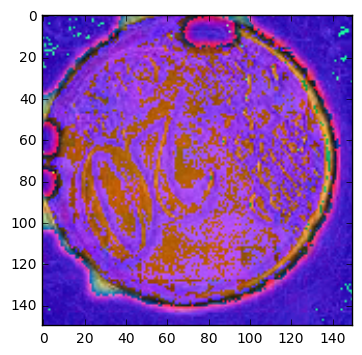

 0.01068264 of 10 cents 

 0.01114923 of 20 cents 

 0.73462641 of 50 cents 



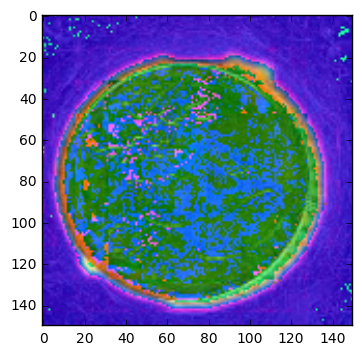

 0.44862512 of 10 cents 

 0.02457055 of 20 cents 

 0.00383144 of 50 cents 



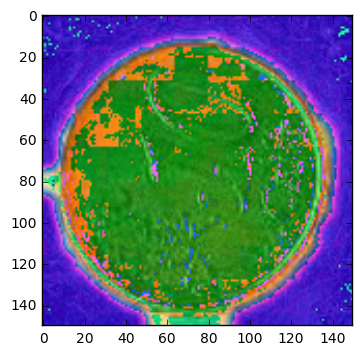

 0.71602851 of 10 cents 

 0.00751597 of 20 cents 

 0.00454018 of 50 cents 



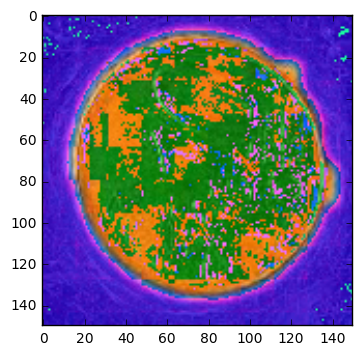

 0.00875101 of 10 cents 

 0.80614948 of 20 cents 

 0.00469530 of 50 cents 



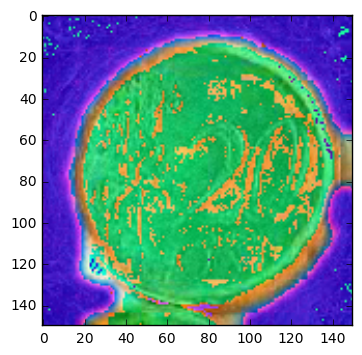

 0.00744103 of 10 cents 

 0.01699677 of 20 cents 

 0.74501777 of 50 cents 



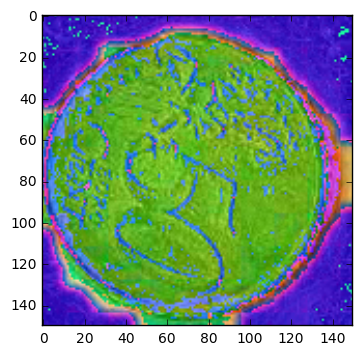

 0.01328955 of 10 cents 

 0.60909975 of 20 cents 

 0.00582793 of 50 cents 



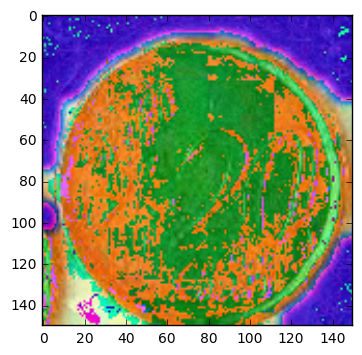

 0.00768725 of 10 cents 

 0.01684202 of 20 cents 

 0.73168302 of 50 cents 



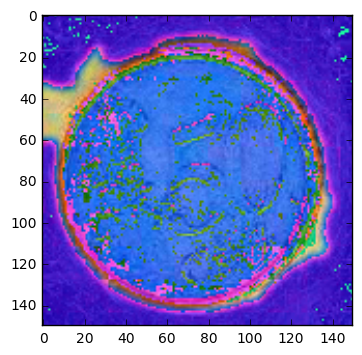

 0.00571893 of 10 cents 

 0.61990744 of 20 cents 

 0.02349227 of 50 cents 



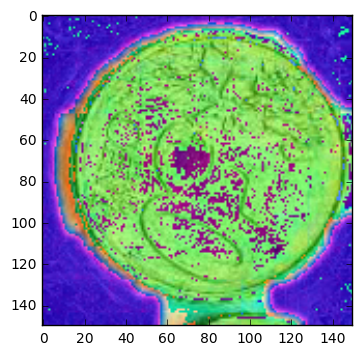

 0.00627202 of 10 cents 

 0.02300340 of 20 cents 

 0.69889951 of 50 cents 



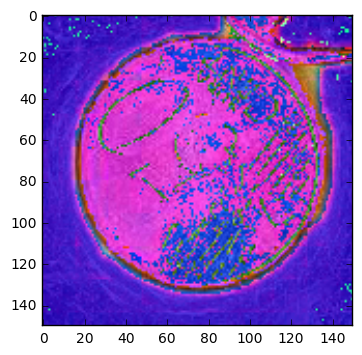

 0.36580706 of 10 cents 

 0.00330474 of 20 cents 

 0.02729268 of 50 cents 



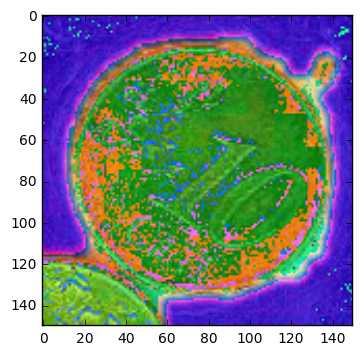

 0.65787452 of 10 cents 

 0.00565314 of 20 cents 

 0.00627677 of 50 cents 



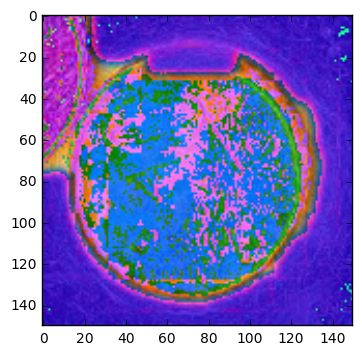

 0.71557981 of 10 cents 

 0.00749345 of 20 cents 

 0.00455815 of 50 cents 



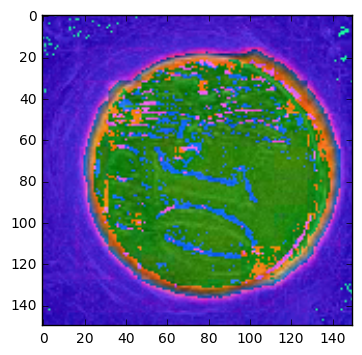

 0.53060913 of 10 cents 

 0.04006191 of 20 cents 

 0.00185900 of 50 cents 



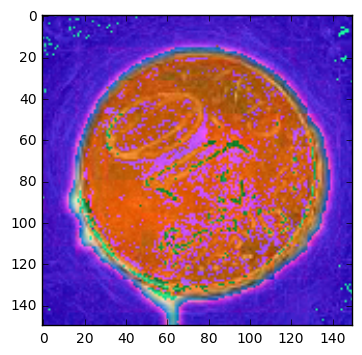

 0.68588036 of 10 cents 

 0.00950404 of 20 cents 

 0.00399061 of 50 cents 



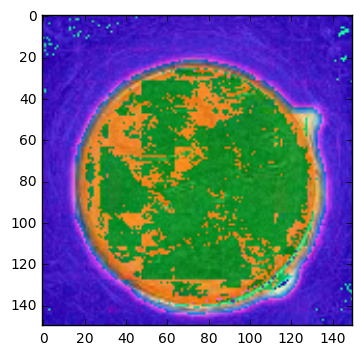

 0.00875571 of 10 cents 

 0.80599147 of 20 cents 

 0.00469582 of 50 cents 



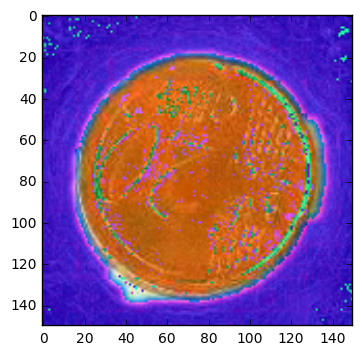

 0.00390225 of 10 cents 

 0.05129369 of 20 cents 

 0.67672306 of 50 cents 



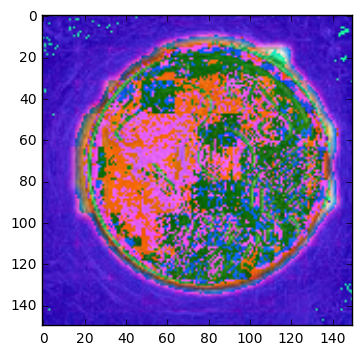

 0.00875239 of 10 cents 

 0.80613643 of 20 cents 

 0.00469503 of 50 cents 



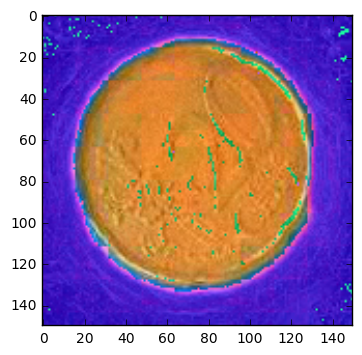

 0.68304980 of 10 cents 

 0.01041817 of 20 cents 

 0.00364136 of 50 cents 



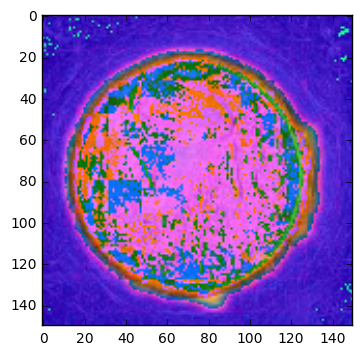

 0.00274508 of 10 cents 

 0.24212845 of 20 cents 

 0.44538569 of 50 cents 



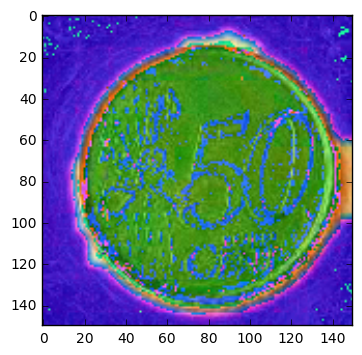

 0.00720945 of 10 cents 

 0.01856340 of 20 cents 

 0.72797531 of 50 cents 



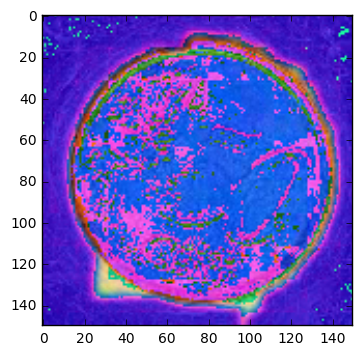

 0.64243567 of 10 cents 

 0.01429433 of 20 cents 

 0.00310139 of 50 cents 



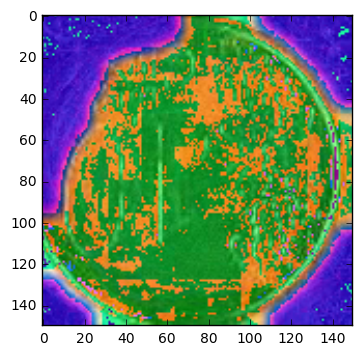

 0.70736045 of 10 cents 

 0.00829128 of 20 cents 

 0.00441037 of 50 cents 



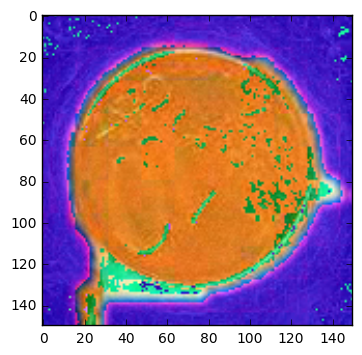

 0.00875395 of 10 cents 

 0.80608976 of 20 cents 

 0.00469525 of 50 cents 



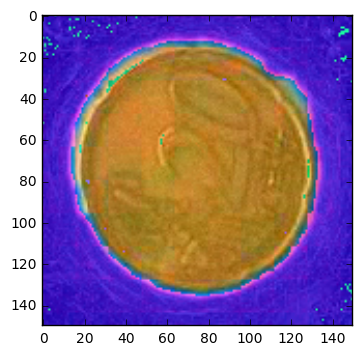

 0.00696938 of 10 cents 

 0.01862487 of 20 cents 

 0.75078005 of 50 cents 



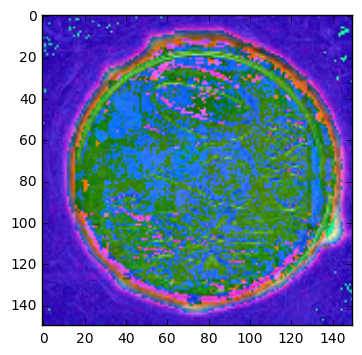

 0.63212317 of 10 cents 

 0.01256880 of 20 cents 

 0.00341051 of 50 cents 



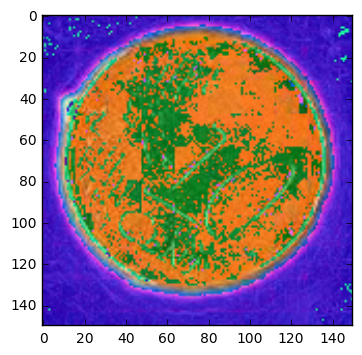

 0.00627267 of 10 cents 

 0.02298924 of 20 cents 

 0.74257076 of 50 cents 



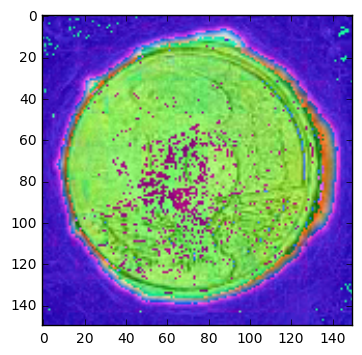

 0.71187878 of 10 cents 

 0.00813827 of 20 cents 

 0.00426401 of 50 cents 



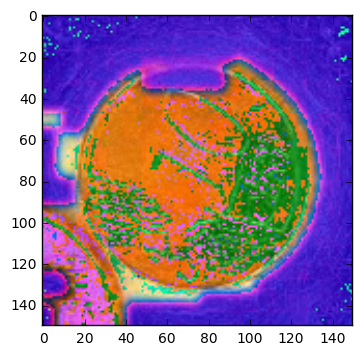

 0.00326051 of 10 cents 

 0.27581871 of 20 cents 

 0.15415505 of 50 cents 



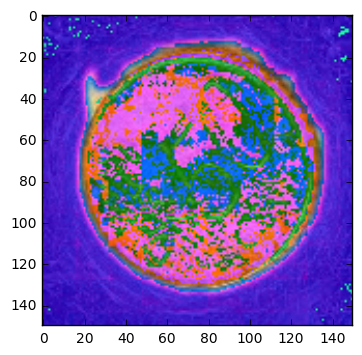

 0.01810564 of 10 cents 

 0.56725723 of 20 cents 

 0.00473118 of 50 cents 



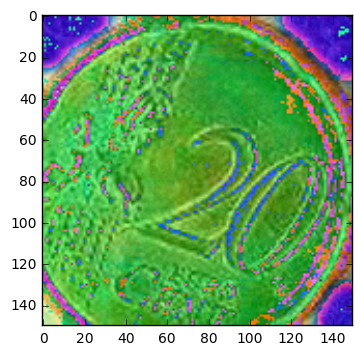

 0.00744303 of 10 cents 

 0.01672632 of 20 cents 

 0.75365084 of 50 cents 



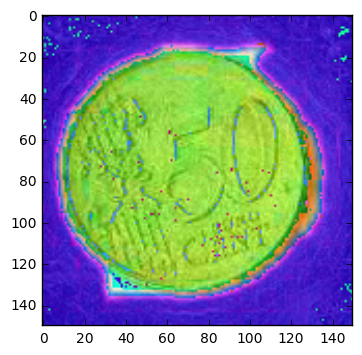

 0.00739344 of 10 cents 

 0.01694784 of 20 cents 

 0.75301230 of 50 cents 



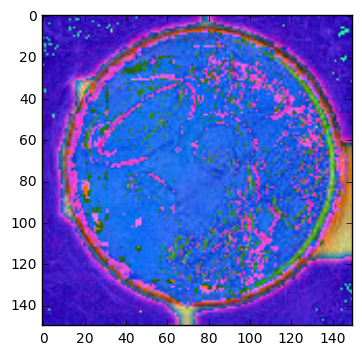

 0.00790735 of 10 cents 

 0.01578240 of 20 cents 

 0.74902898 of 50 cents 



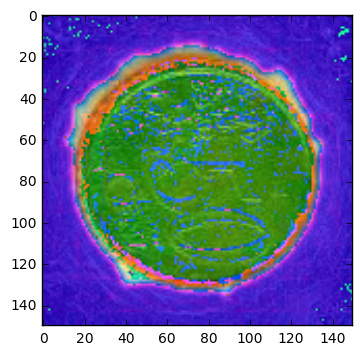

 0.44016910 of 10 cents 

 0.01366074 of 20 cents 

 0.00393843 of 50 cents 



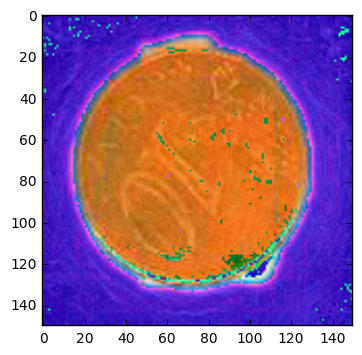

 0.71848845 of 10 cents 

 0.00750724 of 20 cents 

 0.00454448 of 50 cents 



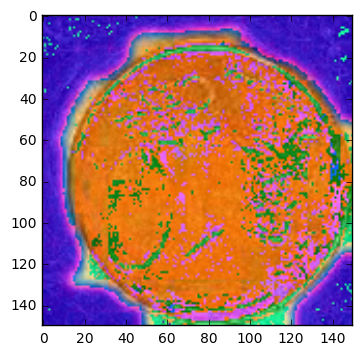

 0.70016026 of 10 cents 

 0.00922749 of 20 cents 

 0.00376939 of 50 cents 



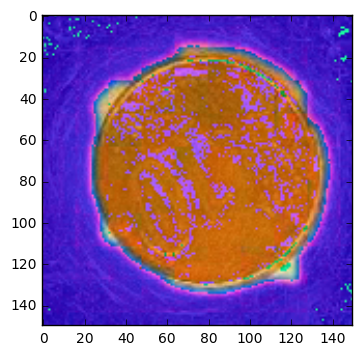

 0.00872157 of 10 cents 

 0.79916698 of 20 cents 

 0.00484563 of 50 cents 



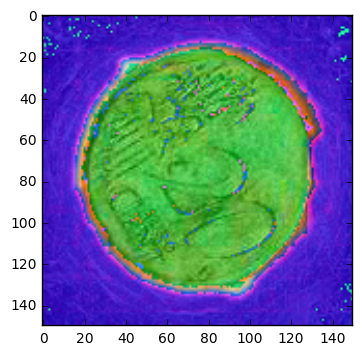

 0.00715571 of 10 cents 

 0.01821632 of 20 cents 

 0.74827772 of 50 cents 



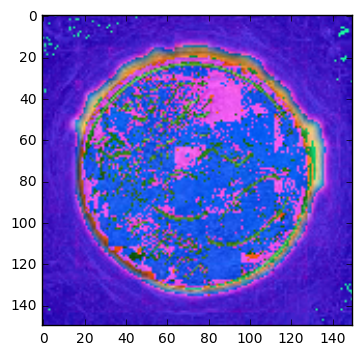

 0.60727024 of 10 cents 

 0.02085440 of 20 cents 

 0.00265150 of 50 cents 



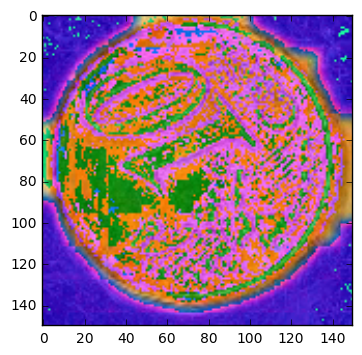

 0.00799948 of 10 cents 

 0.01607060 of 20 cents 

 0.66327906 of 50 cents 



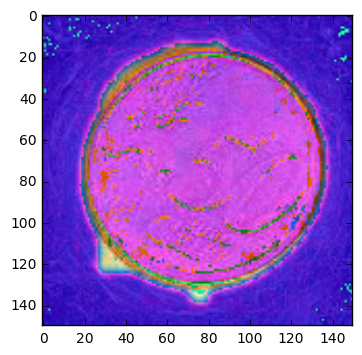

 0.00786670 of 10 cents 

 0.01633197 of 20 cents 

 0.73012185 of 50 cents 



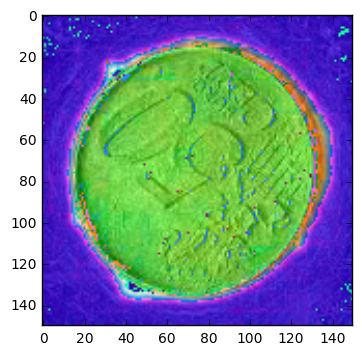

 0.12418170 of 10 cents 

 0.03961030 of 20 cents 

 0.00696638 of 50 cents 



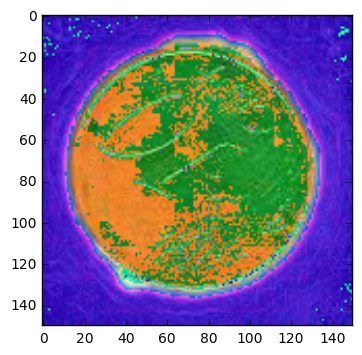

 0.00878710 of 10 cents 

 0.80567014 of 20 cents 

 0.00468727 of 50 cents 



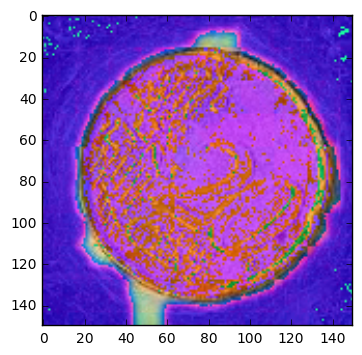

 0.65361834 of 10 cents 

 0.01049535 of 20 cents 

 0.00385103 of 50 cents 



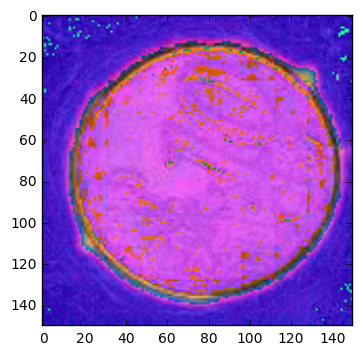

 0.00726293 of 10 cents 

 0.80418408 of 20 cents 

 0.01035703 of 50 cents 



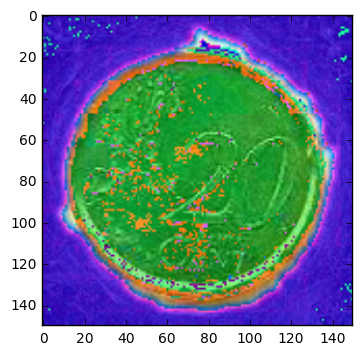

In [8]:
#Useful to test.
LoadAndTest = True
nTest = 45
if LoadAndTest == True:
    #loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_Standard_yuv") #For the standard architecture
    #loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_Reduced_yuv") #For the reduced architecture
    #loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_yuv") #For the reduced deeper architecture
    loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_nobg_yuv") #For the reduced deeper architecture
    # evaluate loaded model on test data
    loaded_model.compile(loss='categorical_crossentropy', optimizer=RMSprop(lr=1e-4), metrics=['accuracy'])
    
    #score_train = loaded_model.evaluate(train, labels_train, verbose=0)
    #score_validation = loaded_model.evaluate(validation, labels_validation, verbose=0)
    #print "Training %s: %.2f%%" % (loaded_model.metrics_names[1], score_train[1]*100)
    #print "Validation %s: %.2f%%" % (loaded_model.metrics_names[1], score_validation[1]*100)    
    
    print("PREDICTIONS \n")
    reduced_test = test[:nTest]
    predictedLabel = loaded_model.predict(reduced_test)

    for i in range(0,nTest):
        print(" %.8f of 10 cents \n" % predictedLabel[i,0])
        print(" %.8f of 20 cents \n" % predictedLabel[i,1])
        print(" %.8f of 50 cents \n" % predictedLabel[i,2])

        plt.imshow(cv2.cvtColor(reduced_test[i], cv2.COLOR_YUV2RGB))
        plt.show()
    
        
    

## Testing with mixed coins images

--- 10 cents ---
--- 10 cents : VALIDATION SET ---
--- 20 cents ---
--- 20 cents : VALIDATION SET ---
--- 50 cents ---
--- 50 cents : VALIDATION SET ---
Loaded model Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_nobg_yuv from disk 

PREDICTIONS 

 0.00735872 of 10 cent 

 0.01714137 of 20 cent 

 0.75203675 of 50 cent 

[[ 0.00735872  0.01714137  0.75203675]]


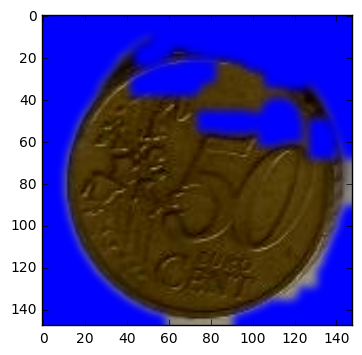

 0.00637458 of 10 cent 

 0.03455750 of 20 cent 

 0.65693974 of 50 cent 

[[ 0.00637458  0.0345575   0.65693974]]


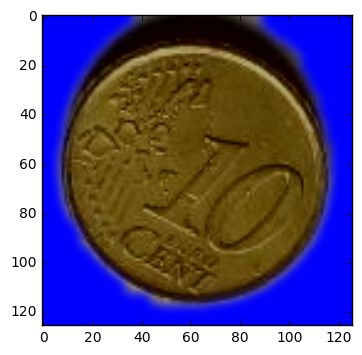

 0.00616423 of 10 cent 

 0.02612603 of 20 cent 

 0.51326454 of 50 cent 

[[ 0.00616423  0.02612603  0.51326454]]


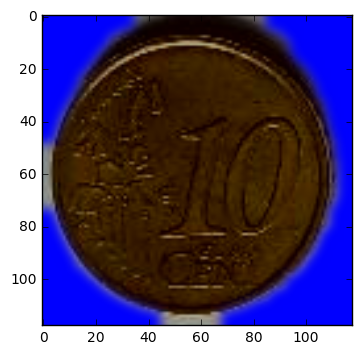

 0.01730529 of 10 cent 

 0.07032745 of 20 cent 

 0.02379732 of 50 cent 

[[ 0.01730529  0.07032745  0.02379732]]


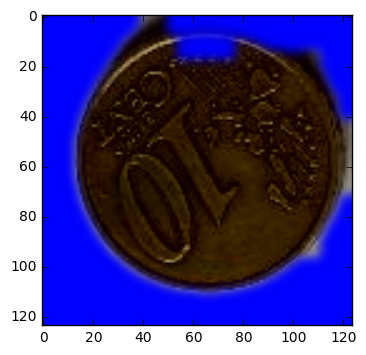

 0.01077122 of 10 cent 

 0.03751805 of 20 cent 

 0.04586412 of 50 cent 

[[ 0.01077122  0.03751805  0.04586412]]


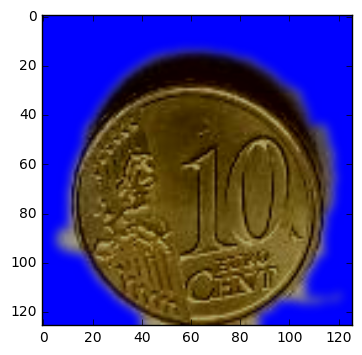

 0.00828994 of 10 cent 

 0.80089837 of 20 cent 

 0.00544453 of 50 cent 

[[ 0.00828994  0.80089837  0.00544453]]


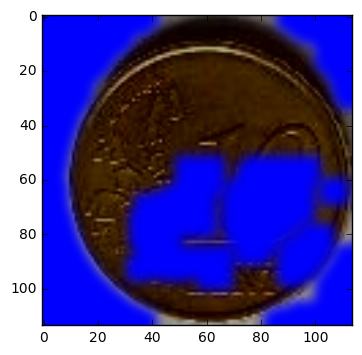

 0.01248149 of 10 cent 

 0.04800980 of 20 cent 

 0.03498751 of 50 cent 

[[ 0.01248149  0.0480098   0.03498751]]


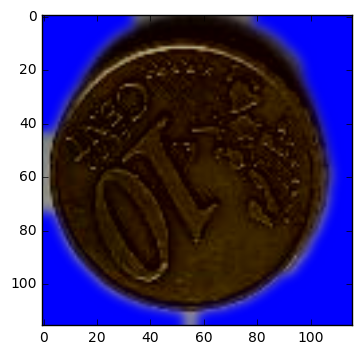

 0.01553459 of 10 cent 

 0.07238221 of 20 cent 

 0.02168820 of 50 cent 

[[ 0.01553459  0.07238221  0.0216882 ]]


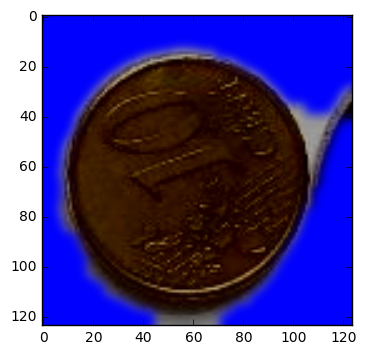

 0.22323893 of 10 cent 

 0.00407863 of 20 cent 

 0.01162147 of 50 cent 

[[ 0.22323893  0.00407863  0.01162147]]


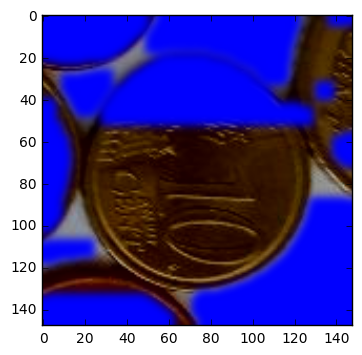

 0.01041039 of 10 cent 

 0.03850483 of 20 cent 

 0.04061745 of 50 cent 

[[ 0.01041039  0.03850483  0.04061745]]


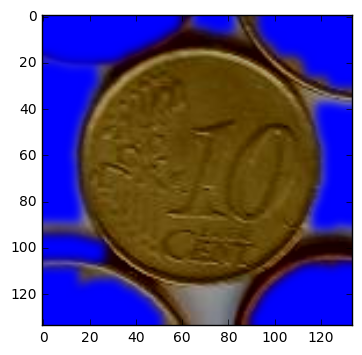

 0.00820659 of 10 cent 

 0.75883442 of 20 cent 

 0.00480896 of 50 cent 

[[ 0.00820659  0.75883442  0.00480896]]


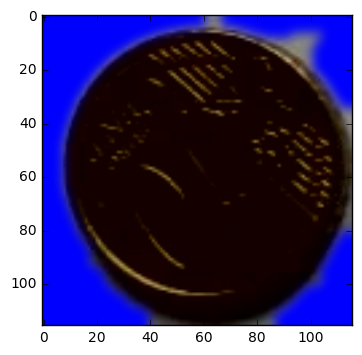

 0.01294206 of 10 cent 

 0.05352319 of 20 cent 

 0.02750327 of 50 cent 

[[ 0.01294206  0.05352319  0.02750327]]


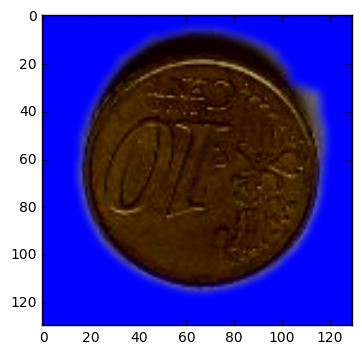

 0.01213524 of 10 cent 

 0.03764471 of 20 cent 

 0.05324576 of 50 cent 

[[ 0.01213524  0.03764471  0.05324576]]


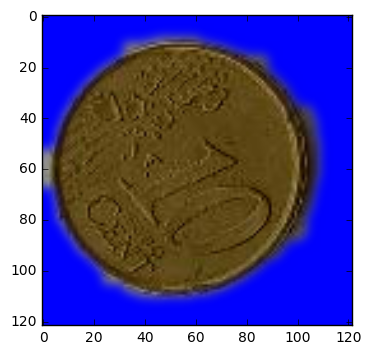

 0.01270024 of 10 cent 

 0.18213601 of 20 cent 

 0.01326427 of 50 cent 

[[ 0.01270024  0.18213601  0.01326427]]


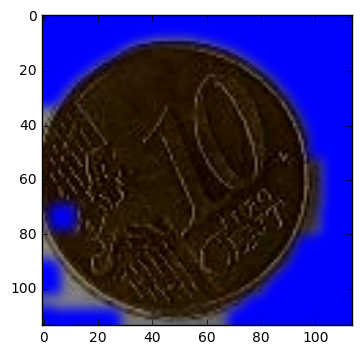

 0.69481194 of 10 cent 

 0.00699927 of 20 cent 

 0.00472556 of 50 cent 

[[ 0.69481194  0.00699927  0.00472556]]


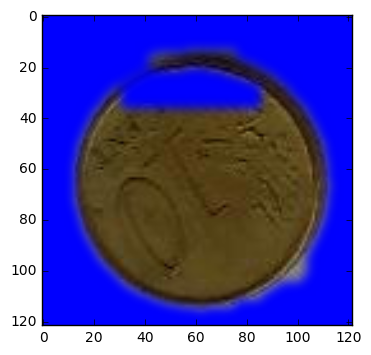

 0.00871125 of 10 cent 

 0.80268097 of 20 cent 

 0.00470782 of 50 cent 

[[ 0.00871125  0.80268097  0.00470782]]


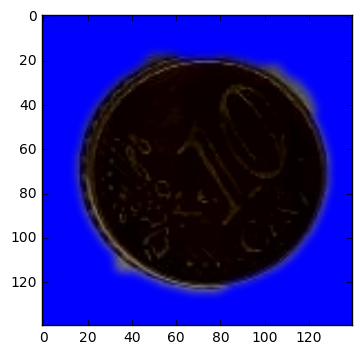

 0.00818264 of 10 cent 

 0.74777257 of 20 cent 

 0.00486099 of 50 cent 

[[ 0.00818264  0.74777257  0.00486099]]


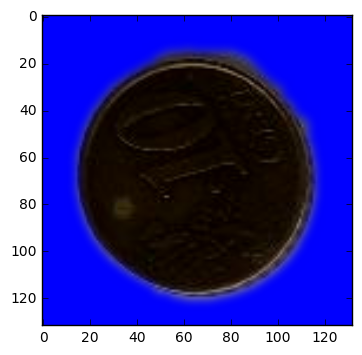

 0.00450593 of 10 cent 

 0.04056236 of 20 cent 

 0.72866988 of 50 cent 

[[ 0.00450593  0.04056236  0.72866988]]


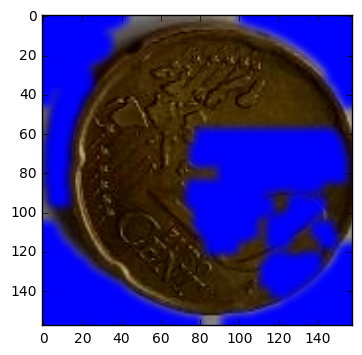

 0.00558238 of 10 cent 

 0.02915633 of 20 cent 

 0.72296429 of 50 cent 

[[ 0.00558238  0.02915633  0.72296429]]


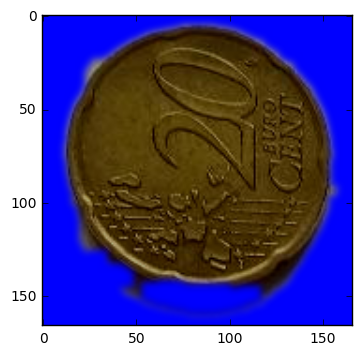

 0.00556968 of 10 cent 

 0.74112988 of 20 cent 

 0.01425262 of 50 cent 

[[ 0.00556968  0.74112988  0.01425262]]


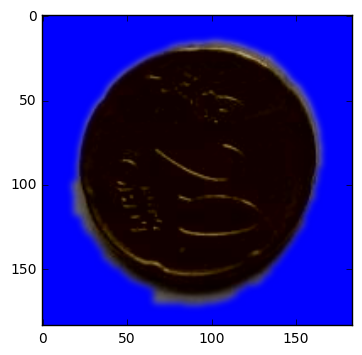

 0.00874884 of 10 cent 

 0.80608296 of 20 cent 

 0.00469771 of 50 cent 

[[ 0.00874884  0.80608296  0.00469771]]


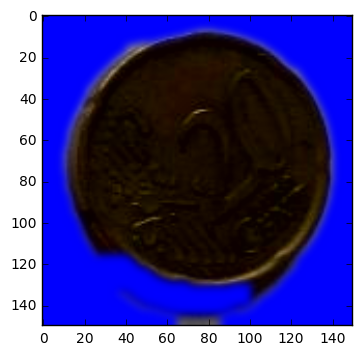

 0.00714909 of 10 cent 

 0.01797491 of 20 cent 

 0.71730608 of 50 cent 

[[ 0.00714909  0.01797491  0.71730608]]


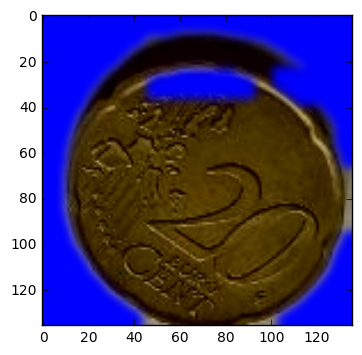

 0.00743928 of 10 cent 

 0.01673655 of 20 cent 

 0.75361252 of 50 cent 

[[ 0.00743928  0.01673655  0.75361252]]


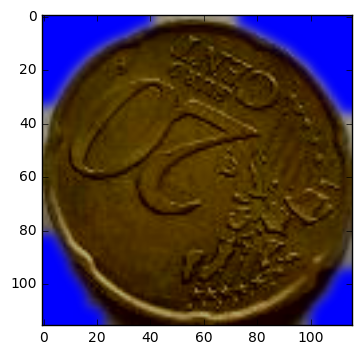

 0.00558530 of 10 cent 

 0.02922113 of 20 cent 

 0.74318409 of 50 cent 

[[ 0.0055853   0.02922113  0.74318409]]


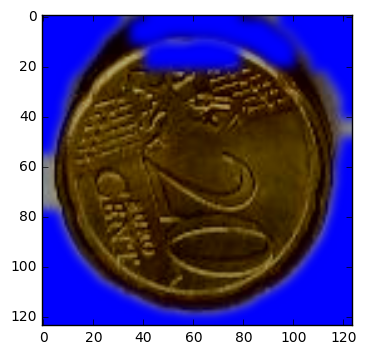

 0.00624138 of 10 cent 

 0.03442176 of 20 cent 

 0.78406107 of 50 cent 

[[ 0.00624138  0.03442176  0.78406107]]


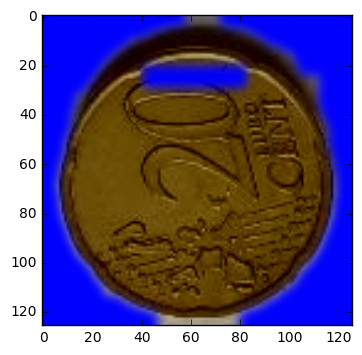

 0.00714909 of 10 cent 

 0.01797491 of 20 cent 

 0.71730608 of 50 cent 

[[ 0.00714909  0.01797491  0.71730608]]


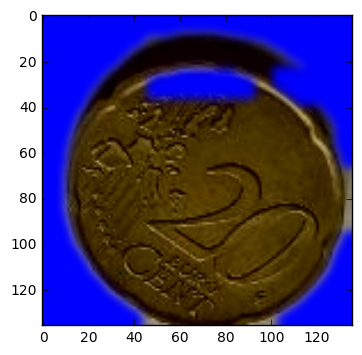

 0.00874478 of 10 cent 

 0.80556673 of 20 cent 

 0.00469780 of 50 cent 

[[ 0.00874478  0.80556673  0.0046978 ]]


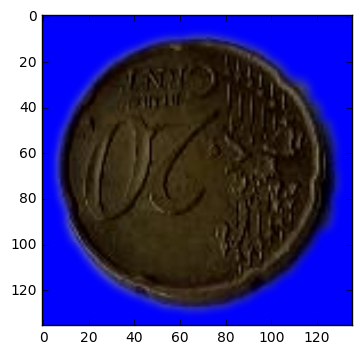

 0.00839020 of 10 cent 

 0.80157435 of 20 cent 

 0.00517364 of 50 cent 

[[ 0.0083902   0.80157435  0.00517364]]


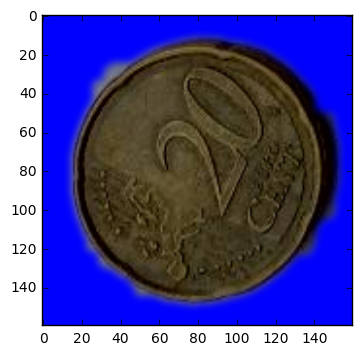

 0.00874972 of 10 cent 

 0.80604589 of 20 cent 

 0.00469566 of 50 cent 

[[ 0.00874972  0.80604589  0.00469566]]


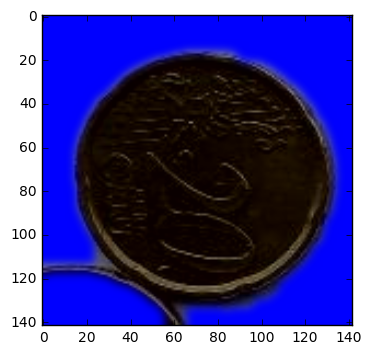

 0.00768127 of 10 cent 

 0.65326768 of 20 cent 

 0.00510238 of 50 cent 

[[ 0.00768127  0.65326768  0.00510238]]


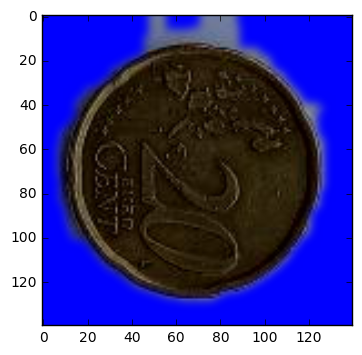

 0.00875063 of 10 cent 

 0.80603856 of 20 cent 

 0.00469595 of 50 cent 

[[ 0.00875063  0.80603856  0.00469595]]


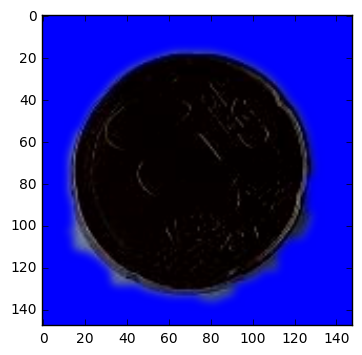

 0.00568557 of 10 cent 

 0.03072638 of 20 cent 

 0.75313914 of 50 cent 

[[ 0.00568557  0.03072638  0.75313914]]


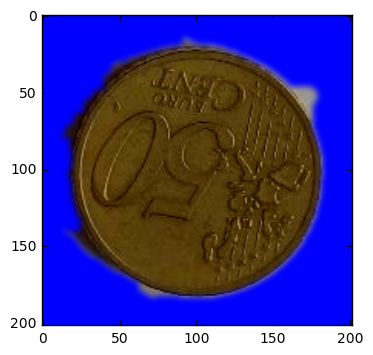

 0.01596696 of 10 cent 

 0.14126039 of 20 cent 

 0.01532532 of 50 cent 

[[ 0.01596696  0.14126039  0.01532532]]


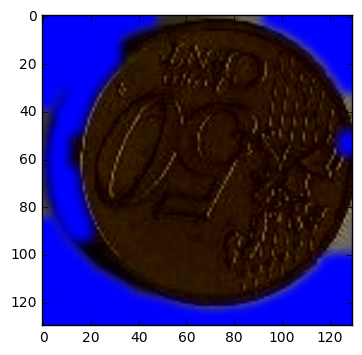

 0.00722156 of 10 cent 

 0.01866982 of 20 cent 

 0.75756168 of 50 cent 

[[ 0.00722156  0.01866982  0.75756168]]


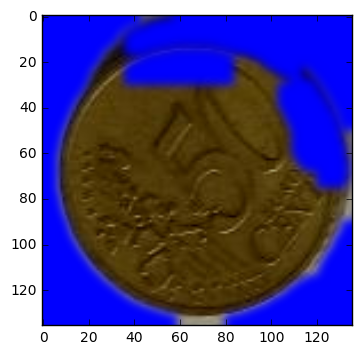

 0.00735872 of 10 cent 

 0.01714137 of 20 cent 

 0.75203675 of 50 cent 

[[ 0.00735872  0.01714137  0.75203675]]


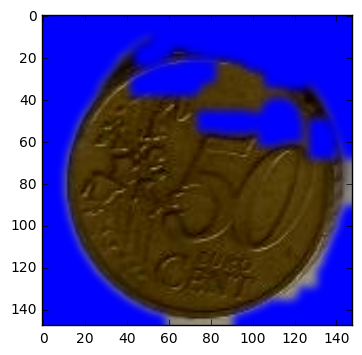

 0.00557123 of 10 cent 

 0.02923243 of 20 cent 

 0.74323803 of 50 cent 

[[ 0.00557123  0.02923243  0.74323803]]


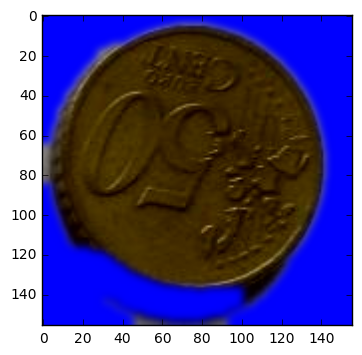

 0.00557904 of 10 cent 

 0.02960227 of 20 cent 

 0.72739130 of 50 cent 

[[ 0.00557904  0.02960227  0.7273913 ]]


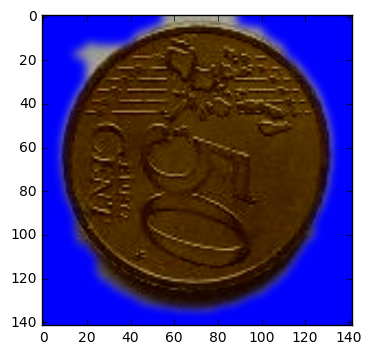

 0.00669815 of 10 cent 

 0.02046171 of 20 cent 

 0.74411345 of 50 cent 

[[ 0.00669815  0.02046171  0.74411345]]


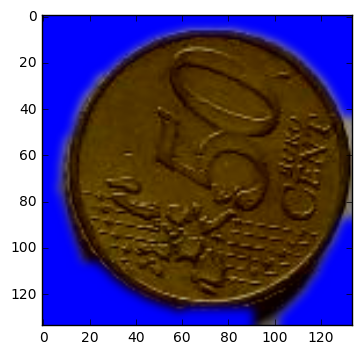

 0.00878369 of 10 cent 

 0.01106752 of 20 cent 

 0.30421013 of 50 cent 

[[ 0.00878369  0.01106752  0.30421013]]


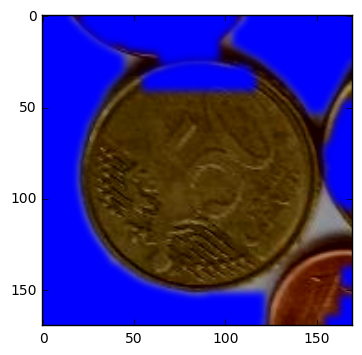

 0.01211474 of 10 cent 

 0.03968206 of 20 cent 

 0.03387894 of 50 cent 

[[ 0.01211474  0.03968206  0.03387894]]


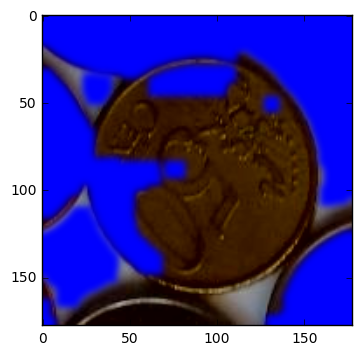

 0.00710300 of 10 cent 

 0.01873805 of 20 cent 

 0.74665242 of 50 cent 

[[ 0.007103    0.01873805  0.74665242]]


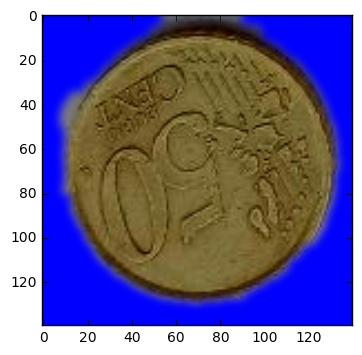

 0.00578319 of 10 cent 

 0.02981689 of 20 cent 

 0.67660791 of 50 cent 

[[ 0.00578319  0.02981689  0.67660791]]


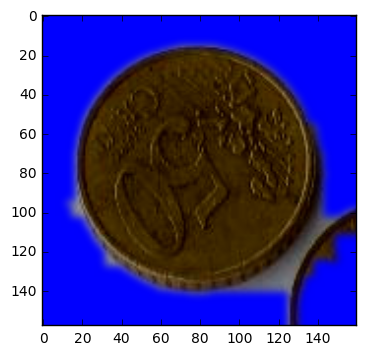

 0.00559287 of 10 cent 

 0.02924868 of 20 cent 

 0.74418414 of 50 cent 

[[ 0.00559287  0.02924868  0.74418414]]


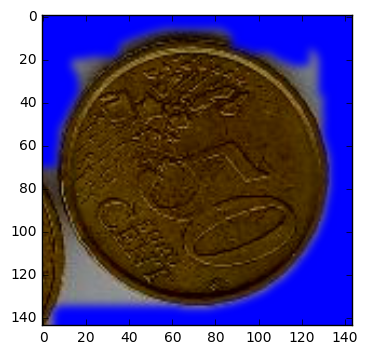

 0.00661732 of 10 cent 

 0.57222891 of 20 cent 

 0.00583352 of 50 cent 

[[ 0.00661732  0.57222891  0.00583352]]


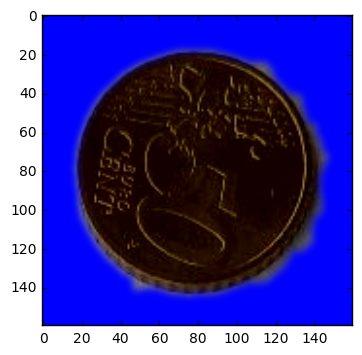

 0.00674858 of 10 cent 

 0.53250498 of 20 cent 

 0.00565087 of 50 cent 

[[ 0.00674858  0.53250498  0.00565087]]


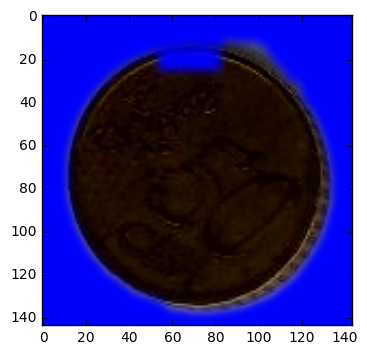

In [13]:
#Useful to test.
TEST_DIR = 'CandidateDataSet2/Processed_RAW/mix/'
#input_file = glob.glob(TEST_DIR+"*.jpg") #Try new Samples
input_file = [TEST_DIR+"P70216-160609_Candidate_6.jpg"]  #For debugging
print("--- 10 cents ---")
input_file.append(TEST_DIR+"P70216-160642_Candidate_10.jpg")
input_file.append(TEST_DIR+"P70216-160642_Candidate_20.jpg")
input_file.append(TEST_DIR+"P70216-160642_Candidate_21.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_27.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_25.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_26.jpg")
input_file.append(TEST_DIR+"P70216-160813_Candidate_37.jpg")
input_file.append(TEST_DIR+"P70216-161849_Candidate_4.jpg")
input_file.append(TEST_DIR+"P70216-161849_Candidate_18.jpg")
input_file.append(TEST_DIR+"P70216-161000_Candidate_34.jpg")
input_file.append(TEST_DIR+"P70216-160854_Candidate_38.jpg")
print("--- 10 cents : VALIDATION SET ---")
VAL_DIR = 'CandidateDataSet2/Processed_RAW/10cent/'
input_file.append(VAL_DIR+"P70216-134319_Candidate_14.jpg")
input_file.append(VAL_DIR+"P70216-134504_Candidate_21.jpg")
input_file.append(VAL_DIR+"P70216-134748_Candidate_5.jpg")
input_file.append(VAL_DIR+"P70216-134440_Candidate_9.jpg")
input_file.append(VAL_DIR+"P70216-134748_Candidate_9.jpg")
print("--- 20 cents ---")
input_file.append(TEST_DIR+"P70216-160459_Candidate_5.jpg")
input_file.append(TEST_DIR+"P70216-160524_Candidate_2.jpg")
input_file.append(TEST_DIR+"P70216-160630_Candidate_9.jpg")
input_file.append(TEST_DIR+"P70216-160630_Candidate_17.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_7.jpg")
input_file.append(TEST_DIR+"P70216-160813_Candidate_8.jpg")
input_file.append(TEST_DIR+"P70216-160854_Candidate_7.jpg")
input_file.append(TEST_DIR+"P70216-160854_Candidate_29.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_7.jpg")
print("--- 20 cents : VALIDATION SET ---")
VAL_DIR = 'CandidateDataSet2/Processed_RAW/20cent/'
input_file.append(VAL_DIR+"P70210-172818_Candidate_14.jpg")
input_file.append(VAL_DIR+"P70210-172835_Candidate_1.jpg")
input_file.append(VAL_DIR+"P70210-173008_Candidate_3.jpg")
input_file.append(VAL_DIR+"P70210-173043_Candidate_15.jpg")
input_file.append(VAL_DIR+"P70210-173134_Candidate_13.jpg")
print("--- 50 cents ---")
input_file.append(TEST_DIR+"P70216-160459_Candidate_6.jpg")
input_file.append(TEST_DIR+"P70216-160434_Candidate_5.jpg")
input_file.append(TEST_DIR+"P70216-160549_Candidate_5.jpg")
input_file.append(TEST_DIR+"P70216-160609_Candidate_6.jpg")
input_file.append(TEST_DIR+"P70216-160630_Candidate_13.jpg")
input_file.append(TEST_DIR+"P70216-160813_Candidate_24.jpg")
input_file.append(TEST_DIR+"P70216-161000_Candidate_26.jpg")
input_file.append(TEST_DIR+"P70216-161849_Candidate_13.jpg")
input_file.append(TEST_DIR+"P70216-161845_Candidate_10.jpg")
print("--- 50 cents : VALIDATION SET ---")
VAL_DIR = 'CandidateDataSet2/Processed_RAW/50cent/'
input_file.append(VAL_DIR+"P70210-165438_Candidate_20.jpg")
input_file.append(VAL_DIR+"P70210-165500_Candidate_7.jpg")
input_file.append(VAL_DIR+"P70210-165718_Candidate_4.jpg")
input_file.append(VAL_DIR+"P70210-165812_Candidate_3.jpg")
input_file.append(VAL_DIR+"P70210-165858_Candidate_4.jpg")
LoadAndTest = True
if LoadAndTest == True:
    #loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_Standard_yuv") #For the standard architecture
    loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_nobg_yuv") #For the reduced architecture
    # evaluate loaded model on test data
    #loaded_model.compile(loss='categorical_crossentropy', optimizer=RMSprop(lr=1e-4), metrics=['accuracy'])
    print("PREDICTIONS \n")
    for kfile in input_file:
        im = Image.open(kfile)
        BLUR = 11
        CANNY_THRESH_1 = 10
        CANNY_THRESH_2 = 200
        MASK_DILATE_ITER = 4
        MASK_ERODE_ITER = 4
        imarray = np.array(im)
        yuv = cv2.cvtColor(imarray, cv2.COLOR_BGR2YUV) #Convert it to yuv
        y, u, v = cv2.split(yuv)
        y = y.astype(np.int16)
        y -= 80
        y = np.maximum(np.zeros(y.shape),y)
        y = np.minimum(255*np.ones(y.shape),y)
        y = y.astype(np.uint8)
        final_yuv = cv2.merge((y, u, v))
        img_bright = cv2.cvtColor(final_yuv, cv2.COLOR_YUV2BGR)
        imarraynobg, mask_nz_count = bgSubstraction(img_bright, BLUR, CANNY_THRESH_1, 
                                                    CANNY_THRESH_2, MASK_DILATE_ITER, 
                                                    MASK_ERODE_ITER)
        while(mask_nz_count < 0.6 * img_bright.shape[0]*img_bright.shape[1]*img_bright.shape[2] and CANNY_THRESH_2 >= 4):
            if CANNY_THRESH_2 < 20:
                CANNY_THRESH_2 -=3
            else:
                CANNY_THRESH_2 -= 10
            imarraynobg, mask_nz_count = bgSubstraction(img_bright, BLUR, CANNY_THRESH_1, 
                                                        CANNY_THRESH_2, MASK_DILATE_ITER, 
                                                        MASK_ERODE_ITER) 
        imarray = np.array(imarraynobg)
        imgResizedTest = cv2.resize(imarray, (ROWS, COLS), interpolation=cv2.INTER_CUBIC)
        M = cv2.getRotationMatrix2D((imgResizedTest.shape[1]/2,imgResizedTest.shape[0]/2),90,1)
        imgResizedTest = cv2.warpAffine(imgResizedTest,M,(imgResizedTest.shape[1],imgResizedTest.shape[0]))
        imgResizedTest = cv2.cvtColor(imgResizedTest, cv2.COLOR_RGB2YUV)
    
        imageResizedTestNorm = np.divide((imgResizedTest - minTrain),(maxTrain - minTrain))
        imgResizedTestNorm = [imageResizedTestNorm for i in range(0,1)]
        imgResizedTestNorm = np.array(imgResizedTestNorm)        
        predictedLabelNorm = loaded_model.predict(imgResizedTestNorm)
        print(" %.8f of 10 cent \n" % predictedLabelNorm[0,0])
        print(" %.8f of 20 cent \n" % predictedLabelNorm[0,1])
        print(" %.8f of 50 cent \n" % predictedLabelNorm[0,2])
        print(predictedLabelNorm)
        
        #imgResizedTest = cv2.cvtColor(imgResizedTest[0], cv2.COLOR_YUV2BGR)
        #imgResizedTest = cv2.cvtColor(imgResizedTest, cv2.COLOR_BGR2RGB)
        plt.imshow(imarray)
        plt.show()

In [ ]:

ROWS = 150
COLS = 150
CHANNELS = 3